# Assignment 3: Classification with Logistic Regression

# Total: /100

## Instructions

* Complete the assignment

* Once the notebook is complete, restart your kernel and rerun your cells

* Submit this notebook to owl by the deadline

* You may use any python library functions you wish to complete the assignment.

## The Dataset

The dataset contains transactions made by credit cards in September 2013 by European cardholders. 
This dataset presents transactions that occurred in two days, where we have 492 frauds out of 284,807 transactions. The dataset is highly unbalanced, the positive class (frauds) account for 0.172% of all transactions.

It contains only numerical input variables which are the result of a PCA transformation. Unfortunately, due to confidentiality issues, we cannot provide the original features and more background information about the data. Features V1, V2, … V28 are the principal components obtained with PCA, the only features which have not been transformed with PCA are 'Time' and 'Amount'. \[You will learn about PCA in a later Lesson.\] Feature 'Time' contains the seconds elapsed between each transaction and the first transaction in the dataset. The feature 'Amount' is the transaction Amount. Feature 'Class' is the response variable and it takes value 1 in case of fraud and 0 otherwise.

You can read more about the data and the variables [here](https://www.kaggle.com/mlg-ulb/creditcardfraud).

In [3]:
# You may need these
import pandas as pd
import seaborn as sns
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, roc_curve, precision_recall_curve, auc


import matplotlib.pyplot as plt
%matplotlib inline

## Question 1: /5 pts

Read in the `creditcard.csv` dataset and display the first 5 rows.


In [4]:
# Question 1 code here
credit = pd.read_csv("creditcard.csv")
credit.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


## Question 2: /5 pts

Then split the data into train and test for the outcome/response and the predictor variables. Hold out 50% of observations as the test set.  Pass `random_state=0` to `train_test_split` to ensure you get the same train and tests sets as the solution.

In [5]:
# Question 2 code here.

X = credit.Amount.values.reshape(-1, 1)
y = credit.Class.values

Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size=0.5, random_state=0)


## Question 3: /5 pts

Read the documentation for [sklearn's `LogisticRegression`](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html).  In no more than 2 sentences per bullet point, answer the following in your own words.

* Does `LogisticRegression` use a penalty by default?  If yes, what penalty?

**YOUR ANSWER HERE:** 

Yes, the L2 penalty is the default setting.
    
* If we apply a penalty during learning, what difference do you expect to see in the resulting coefficients, relative to not applying a penalty during learning?

**YOUR ANSWER HERE:** 

Applying a penalty will prevent excessively large parameter estimates by shrinking the coefficients towards 0, therefore I would expect coefficients that are smaller/closer to 0 than when no penalty is applied.
    
* If using the default settings of `LogisticRegression` in `sklearn`, should you include a column of 1s in your feature/design matrix? Briefly explain why or why not.

**YOUR ANSWER HERE:** 

No, you should not include a column of 1s in your feature matrix because the fit_intercept parameter is set to True by default, which automatically adds a column of ones.


## Question 4: /15 pts

Create a instance of sklearn's `LogisticRegression` object for unpenalized logistic regression. Note: If you get a warning about convergence of `coef_`, try increasing the `max_iter` parameter.  I used `max_iter=10000` which seems to supress the warning.

Using this object, **run a logisitic regression analysis** of `Class` (y-variable) against `Amount` (x-variable) using your training data. 

Then **make a plot with three main components based on the analysis**:
1. Scatter-plot of `Amount` and `Outcome` on your test data
2. A curve showing the prediction (0 or 1, using `predict` - this curve will jump between 0 and 1) as a function of `Amount`
3. A curve showing the predicted probability of a positive outcome (using `predict_proba`) as a function of `Amount`. Note that `predict_proba` will return both p(Outcome=0) and p(Outcome=1) in an array.

Intercept:  [-6.38060759] 
Coefficients:  [[0.00032136]]


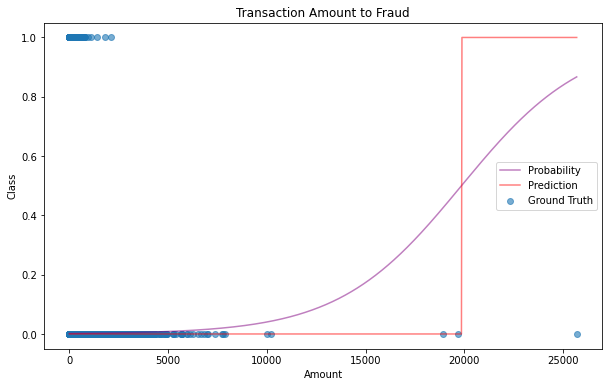

In [6]:
# Question 4 code here

logistic_regression = LogisticRegression(max_iter=10000, penalty='none')
creditlr = logistic_regression.fit(Xtrain, ytrain)

print('Intercept: ', creditlr.intercept_, '\nCoefficients: ', creditlr.coef_)

linspace = np.linspace(0, Xtest.max(), 1000).reshape(-1, 1)
probability = creditlr.predict_proba(linspace)
prediction = creditlr.predict(linspace)

plt.figure(figsize=(10, 6))
plt.scatter(Xtest, ytest, label='Ground Truth', alpha=0.6)
plt.plot(linspace, probability[:,1], color='purple', label='Probability', alpha=0.5)
plt.plot(linspace, prediction, color='red', label='Prediction', alpha=0.5)
plt.xlabel('Amount')
plt.ylabel('Class')
plt.legend()
plt.title('Transaction Amount to Fraud')
plt.show()




## Question 5: 15 pts

Compute the label-based criteria we discussed in the Lesson for your amount-only classifier **using the test data**. Use a threshold of 0.5. Answer the questions in this text box below.

* How many of the test instances are labeled positive by your classifier?

**YOUR ANSWER HERE:** 

**1** test instance is labeled positive by the classifier.

* Choose one of the positively-labeled test instances, and explain why the classifier labeled it positive.

**YOUR ANSWER HERE:** 

The 1 positively-labeled test instance was labeled positive because the classifier learned that higher transaction amounts are fraudulent. The data point had a probability larger than 0.5 of being fraudulent, therefore it was labeled as positive.

* Is this classifier useful for finding fraudulent transactions? Explain in one or two sentences.

**YOUR ANSWER HERE:** 

This classifier is not useful for finding fraudulent transactions because it only bases its predictions off of one criteria (Amount). This resulted in a classifier that has a recall of 0%, meaning that there were no correct positive identifications of fraud.


In [7]:
# Calculate performance measures from scratch
# TP: true postives 
# TN: true negatives 
# FP: False positives 
# FN: False negatives
def compute_performance(yhat, y, classes):
    # First, get tp, tn, fp, fn
    tp = sum(np.logical_and(yhat == classes[1], y == classes[1]))
    tn = sum(np.logical_and(yhat == classes[0], y == classes[0]))
    fp = sum(np.logical_and(yhat == classes[1], y == classes[0]))
    fn = sum(np.logical_and(yhat == classes[0], y == classes[1]))

    print(f"tp: {tp} tn: {tn} fp: {fp} fn: {fn}")
    
    # Accuracy
    acc = (tp + tn) / (tp + tn + fp + fn)
    
    # Precision
    # "Of the ones I labeled +, how many are actually +?"
    precision = tp / (tp + fp)
    
    # Recall
    # "Of all the + in the data, how many do I correctly label?"
    recall = tp / (tp + fn)    
    
    # Sensitivity
    # "Of all the + in the data, how many do I correctly label?"
    sensitivity = recall
    
    # Specificity
    # "Of all the - in the data, how many do I correctly label?"
    specificity = tn / (fp + tn)
    
    # Print results
    
    print("Accuracy:",round(acc,3),"Recall:",round(recall,3),"Precision:",round(precision,3),
          "Sensitivity:",round(sensitivity,3),"Specificity:",round(specificity,3))

## Put code here to compute criteria:
ytest_hat = creditlr.predict(Xtest) #Threshold of 0.5 is the default threshold
compute_performance(ytest_hat, ytest, creditlr.classes_)

## Put code here to compute whatever else you might need to answer the question.



tp: 0 tn: 142160 fp: 1 fn: 243
Accuracy: 0.998 Recall: 0.0 Precision: 0.0 Sensitivity: 0.0 Specificity: 1.0


## Question 6: /10 pts
Now fit a logistic regression model to the training data and include all the variables in the data frame (except for `Class`) in the cell below. You will want to make a new object like you did for the simpler model. Answer the following question.

* According to this more complex model, are larger or smaller Amounts more strongly associated with fraud, if all other variables are held equal?

**YOUR ANSWER HERE:** 

According to this more complex model, smaller amounts are more strongly associated with fraud. The coefficient for Amount, -0.008784200743263654, is negative, meaning that the probability of a transaction being fraudulent decreases slightly as the Amount increases.


In [8]:
# Code for Question 6 # I added a 2 after each variable name to differentiate between the two classifiers

X2 = credit.drop('Class', axis='columns').values
y2 = credit.Class.values
amount_index = credit.drop('Class', axis='columns').columns.get_loc('Amount')

Xtrain2, Xtest2, ytrain2, ytest2 = train_test_split(X2, y2, test_size=0.5, random_state=0)

linear_regression2 = LogisticRegression(penalty='none')
creditlr2 = linear_regression2.fit(Xtrain2, ytrain2)

print('Intercept: ', creditlr2.intercept_, '\nCoefficients: ', creditlr2.coef_, 
    '\n\nProof for written answer: \nAmount Coefficient: ', creditlr2.coef_[0, amount_index])

Intercept:  [-1.45451071] 
Coefficients:  [[-8.69840886e-05  5.57128512e-01 -7.97854173e-01 -6.41863766e-01
   1.69743539e-01  2.37134902e-01 -1.06900739e-01  3.65378449e-01
  -3.25857490e-01 -5.24313093e-01 -3.57961756e-01 -1.58210185e-01
  -9.28524345e-02 -3.71867385e-01 -1.05432973e+00 -3.68981254e-01
  -4.24220222e-01 -7.21013509e-01 -3.34964588e-02  7.18348930e-02
   4.41063687e-02  2.93889459e-01  3.03084355e-01  3.92636315e-02
  -3.01937044e-02 -2.95495329e-01  6.75441320e-02 -6.47630067e-02
   6.17262229e-02 -8.78420074e-03]] 

Proof for written answer: 
Amount Coefficient:  -0.008784200743263654


## Question 7: /15 pts

In the cell below, Compute the label-based criteria we discussed in the Lesson for new classifier using the test data. (You don't have to copy the function down into this cell; just call it again here.) Use a threshold of 0.5. Answer the questions in this text box below.

* How many of the test instances are labeled positive by your classifier?

**YOUR ANSWER:** 

Adding up the true positives and false positives results in **215** test instances labeled as positive.

* Is this classifier **better or worse than the amount-only classifier** for finding fraudulent transactions? Explain in one or two sentences.*

**YOUR ANSWER:** 

This classifier is **better** than the amount-only classifier for finding fraudulent transactions because it has a higher accuracy and precision, but most importantly it has a higher recall. The Amount-only classifier didn't catch a single fraud (0% recall), however this classifier caught 66.3% of the frauds.


In [9]:
# Code for Question 7
ytest2_hat = creditlr2.predict(Xtest2) #Threshold of 0.5 is the default threshold
compute_performance(ytest2_hat, ytest2, creditlr2.classes_)


tp: 161 tn: 142107 fp: 54 fn: 82
Accuracy: 0.999 Recall: 0.663 Precision: 0.749 Sensitivity: 0.663 Specificity: 1.0


# Question 8: /15 pts

Plot ROC curves for both of your classifiers using the cells below, then answer the following questions, computing whatever quantities you need to answer them.

* Which classifier has a higher estimated probability of correctly distinguishing between a positive and a negative instance? How do you know?

**YOUR ANSWER:** 

The all-variable classifier has a higher estimated probability of correctly distinguishing between a positive and a negative instance. I know this because the all-variable classifier has an AUROC closer to 1, meaning that the classifier is closer to being perfect.

* How could you explain a result where a logistic regression classifier produces an AUROC that is "worse than random", i.e. less than 0.5, even on its training set?

**YOUR ANSWER:** 

This can be happen due to a lack of variables, therefore the classifier cannot produce a complex enough model. A "worse than random" result can be negated to receive a better result.


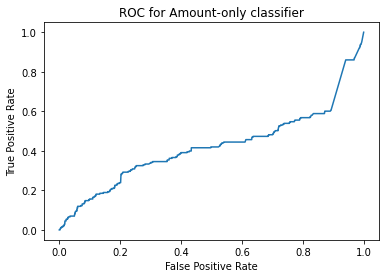

AUROC:  0.42178603619387894


In [10]:
# ROC for Amount-only classifier
ytest_prob = creditlr.predict_proba(Xtest)
fpr, tpr, _ = roc_curve(ytest, ytest_prob[:,1], pos_label=1)
ax = sns.lineplot(fpr, tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC for Amount-only classifier')
plt.show()
print('AUROC: ', auc(fpr,tpr))


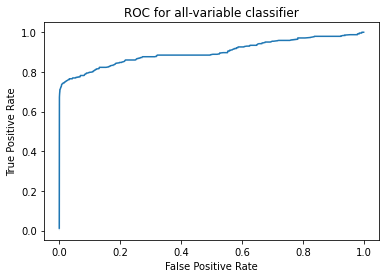

AUROC:  0.8990994474096965


In [11]:
# ROC for all-variable classifier
ytest2_prob = creditlr2.predict_proba(Xtest2)
fpr, tpr, _ = roc_curve(ytest2, ytest2_prob[:,1], pos_label=1)
ax = sns.lineplot(fpr, tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC for all-variable classifier')
plt.show()
print('AUROC: ', auc(fpr, tpr))


# Question 9: /15 pts

Plot precision-recall curves for both of your classifiers using the cell below. Be sure to label your axes.

* Which classifier is preferable if we want to recover at least 60% of fraudulent transactions?

**YOUR ANSWER:** 

The all-variable classifier is preferable because at 60% recall, we have over 80% precision. However, with the amount-only classifier, the precision is basically inexistent no matter which amount of recall we want (looking at the y-axis, it only goes up to a maximum 1.4% precision). Higher precision is favourable, because we don't want to needlessly mark every transaction as fraudulent.


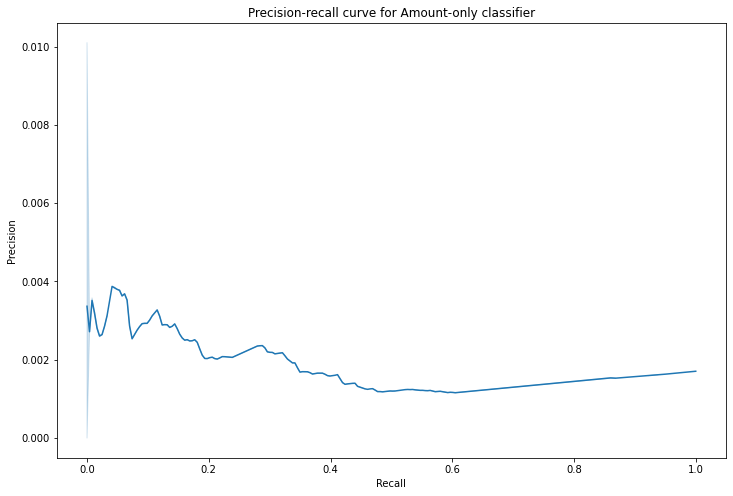

In [12]:
# PRC for Amount-only classifier
p, r , _ = precision_recall_curve(ytest, ytest_prob[:,1], pos_label=1)
plt.figure(figsize=(12, 8))
ax = sns.lineplot(r, p)
plt.ylabel('Precision')
plt.xlabel('Recall')
plt.title('Precision-recall curve for Amount-only classifier')
plt.show()

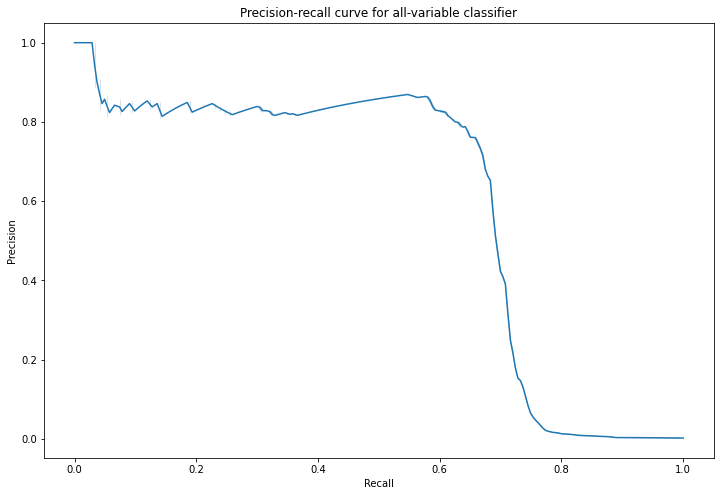

In [13]:
# PRC for all-variable classifier
p, r , _ = precision_recall_curve(ytest2, ytest2_prob[:,1], pos_label=1)
plt.figure(figsize=(12, 8))
ax = sns.lineplot(r, p)
plt.ylabel('Precision')
plt.xlabel('Recall')
plt.title('Precision-recall curve for all-variable classifier')
plt.show()